In [1]:
import torch
import numpy as np
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

from scarches.dataset.trvae.data_handling import remove_sparsity
from lataq.models import EMBEDCVAE
from lataq.exp_dict import EXPERIMENT_INFO

sc.settings.set_figure_params(dpi=200, frameon=False)
sc.set_figure_params(dpi=500)
plt.rcParams['figure.figsize'] = (5, 5)
torch.set_printoptions(precision=3, sci_mode=False, edgeitems=7)

%load_ext autoreload
%autoreload 2

In [2]:
PARAMS = {
    'EPOCHS': 50,                                      #TOTAL TRAINING EPOCHS
    'N_PRE_EPOCHS': 40,                                #EPOCHS OF PRETRAINING WITHOUT LANDMARK LOSS
    #'DATA_DIR': '../../lataq_reproduce/data',          #DIRECTORY WHERE THE DATA IS STORED
    #'DATA': 'pancreas',                                #DATA USED FOR THE EXPERIMENT
    'EARLY_STOPPING_KWARGS': {                         #KWARGS FOR EARLY STOPPING
        "early_stopping_metric": "val_landmark_loss",  ####value used for early stopping
        "mode": "min",                                 ####choose if look for min or max
        "threshold": 0,
        "patience": 20,
        "reduce_lr": True,
        "lr_patience": 13,
        "lr_factor": 0.1,
    },
    'LABELED_LOSS_METRIC': 'dist',           
    'UNLABELED_LOSS_METRIC': 'dist',
    'LATENT_DIM': 25,
    'ALPHA_EPOCH_ANNEAL': 1e3,
    'CLUSTERING_RES': 2,
    'HIDDEN_LAYERS': 3,
    'ETA': 5,
}

In [3]:
adata_raw = sc.read(
    '/storage/groups/ml01/workspace/'
    'hlca_lisa.sikkema_malte.luecken/'
    'HLCA_reproducibility/data/HLCA_extended/'
    'extension_datasets/raw/Meyer/Meyer_2021_raw.h5ad'
)

In [4]:
adata = sc.read(
    '/storage/groups/ml01/workspace/'
    'hlca_lisa.sikkema_malte.luecken/'
    'HLCA_reproducibility/data/HLCA_extended/'
    'HLCA_core_plus_single_study/meyer/'
    'HLCA_meyer_adata_full_tcnorm_log1p.h5ad'
)

In [5]:
adata_counts = sc.read(
    '../data/hlca_counts.h5ad'
)

In [6]:
adata_meyer = adata[adata.obs['study'] == 'Meyer_2021']

In [7]:
adata_raw.obs = adata_meyer.obs.reindex(adata_raw.obs.index).copy()
adata_raw = adata_raw[:, adata_counts.var_names]
adata_raw

View of AnnData object with n_obs × n_vars = 128628 × 1996
    obs: 'sample', 'original_celltype_ann', 'study_long', 'study', 'last_author_PI', 'subject_ID', 'subject_ID_as_published', 'pre_or_postnatal', 'age_in_years', 'age_range', 'sex', 'ethnicity', 'mixed_ethnicity', 'smoking_status', 'smoking_history', 'BMI', 'known_lung_disease', 'condition', 'subject_type', 'cause_of_death', 'sample_type', 'anatomical_region_coarse', 'anatomical_region_detailed', 'tissue_dissociation_protocol', 'cells_or_nuclei', 'single_cell_platform', "3'_or_5'", 'enrichment', 'sequencing_platform', 'reference_genome_coarse', 'ensembl_release_reference_genome', 'cell_ranger_version', 'disease_status', 'fresh_or_frozen', 'cultured', 'cell_viability_%', 'comments', 'Processing_site', 'dataset', 'anatomical_region_level_1', 'anatomical_region_level_2', 'anatomical_region_level_3', 'anatomical_region_highest_res', 'age', 'original_ann_level_1', 'original_ann_level_2', 'original_ann_level_3', 'original_ann_level_4

In [8]:
adata_raw.obs['ann_finest_level'] = [
        adata_raw.obs.loc[cell, f"original_ann_level_{highest_lev}"]
        for cell, highest_lev in zip(
            adata_raw.obs.index, adata_raw.obs.original_ann_highest_res
        )
]

Trying to set attribute `.obs` of view, copying.


         Falling back to preprocessing with `sc.pp.pca` and default params.


... storing 'ann_finest_level' as categorical


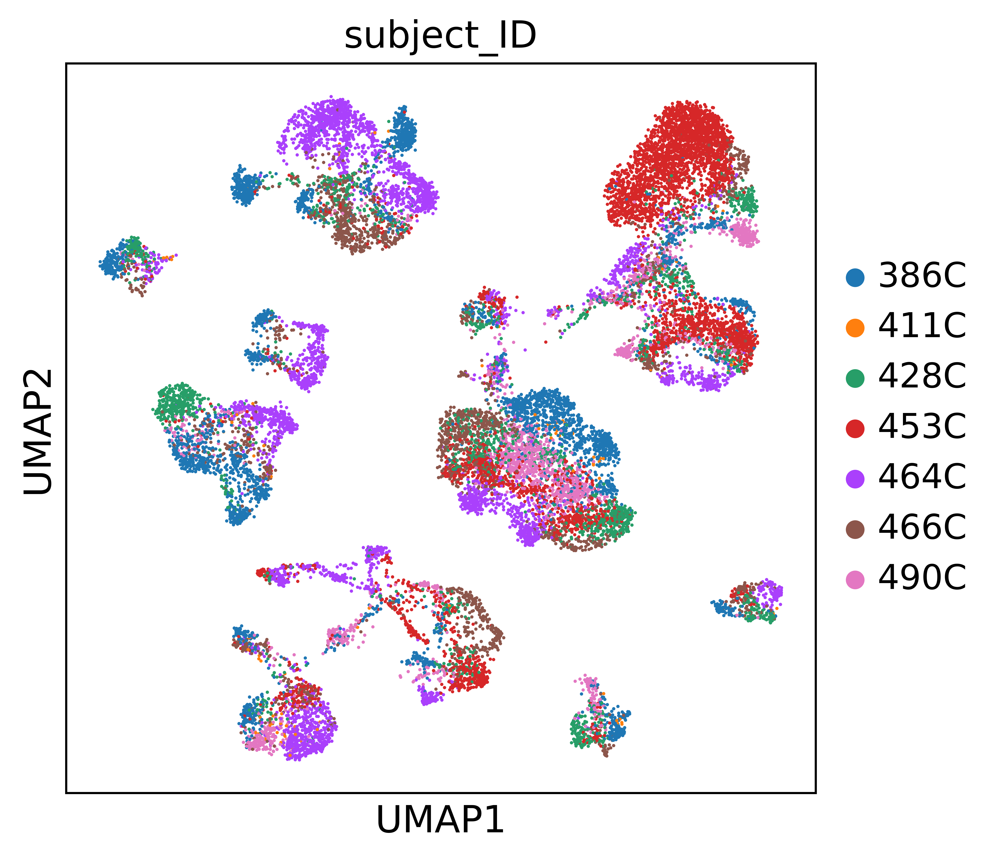

In [9]:
adata_pp = adata_raw.copy()
sc.pp.normalize_total(adata_pp)
sc.pp.log1p(adata_pp)

adata_raw_sub = sc.pp.subsample(adata_pp, n_obs=20000, copy=True)
sc.pp.neighbors(adata_raw_sub)
sc.tl.umap(adata_raw_sub)
sc.pl.umap(adata_raw_sub, color='subject_ID')

In [10]:
sc.pl.umap(adata_raw_sub, color='ann_finest_level')

In [11]:
adata_raw.obs['ann_finest_level']

AACTTTCAGATGTGGC-WSSS8123924          Interstitial macrophages
ACCTTTAGTGAGTGAC-WSSS8123924                       Fibroblasts
ACGATACTCCGCTGTT-WSSS8123924                      Lymphatic EC
ACTGAACGTAGTGAAT-WSSS8123924                       Fibroblasts
AGAGTGGTCAACACTG-WSSS8123924                       Fibroblasts
                                                ...           
TTTGTCAGTTATCCGA-HCATisStab7732262                 CD4 T cells
TTTGTCAGTTCAGTAC-HCATisStab7732262                  Mast cells
TTTGTCATCACCGGGT-HCATisStab7732262                    NK cells
TTTGTCATCGCGTTTC-HCATisStab7732262         Gamma-delta T cells
TTTGTCATCTAACGGT-HCATisStab7732262              CD4T cells TRM
Name: ann_finest_level, Length: 128628, dtype: object

In [12]:
condition_key = 'subject_ID'
cell_type_key = ['ann_finest_level']

In [13]:
lataq_query = EMBEDCVAE.load_query_data(
    adata=adata_raw,
    reference_model='hlca_core_new/',
    labeled_indices=[],
)

AnnData object with n_obs × n_vars = 128628 × 1996
    obs: 'sample', 'original_celltype_ann', 'study_long', 'study', 'last_author_PI', 'subject_ID', 'subject_ID_as_published', 'pre_or_postnatal', 'age_in_years', 'age_range', 'sex', 'ethnicity', 'mixed_ethnicity', 'smoking_status', 'smoking_history', 'BMI', 'known_lung_disease', 'condition', 'subject_type', 'cause_of_death', 'sample_type', 'anatomical_region_coarse', 'anatomical_region_detailed', 'tissue_dissociation_protocol', 'cells_or_nuclei', 'single_cell_platform', "3'_or_5'", 'enrichment', 'sequencing_platform', 'reference_genome_coarse', 'ensembl_release_reference_genome', 'cell_ranger_version', 'disease_status', 'fresh_or_frozen', 'cultured', 'cell_viability_%', 'comments', 'Processing_site', 'dataset', 'anatomical_region_level_1', 'anatomical_region_level_2', 'anatomical_region_level_3', 'anatomical_region_highest_res', 'age', 'original_ann_level_1', 'original_ann_level_2', 'original_ann_level_3', 'original_ann_level_4', 'orig

In [14]:
lataq_query.train(
    n_epochs=100,
    pretraining_epochs=80,
    early_stopping_kwargs=PARAMS['EARLY_STOPPING_KWARGS'],
    alpha_epoch_anneal=PARAMS['ALPHA_EPOCH_ANNEAL'],
    eta=0,
    clustering_res=PARAMS['CLUSTERING_RES'],
    labeled_loss_metric=PARAMS['LABELED_LOSS_METRIC'],
    unlabeled_loss_metric=PARAMS['UNLABELED_LOSS_METRIC'],
    weight_decay=0,
    use_stratified_sampling=False
)

Therefore integer value of those labels is set to -1
Therefore integer value of those labels is set to -1
Therefore integer value of those labels is set to -1
Therefore integer value of those labels is set to -1
loaders init
loaders init done
0.00052642822265625
 |████████████████----| 80.0%  - val_loss: 560.3971775168 - val_trvae_loss: 560.3971775168
Initializing unlabeled landmarks with Leiden-Clustering with an unknown number of clusters.
Leiden Clustering succesful. Found 48 clusters.
 |████████████████████| 100.0%  - val_loss: 563.6435673780 - val_trvae_loss: 563.6435673780 - val_landmark_loss: 0.0000000000 - val_unlabeled_loss: 0.3574000193
Saving best state of network...
Best State was in Epoch 80


In [15]:
results_dict = lataq_query.classify(
    adata_raw.X.A, 
    adata_raw.obs[condition_key], 
    metric=PARAMS['LABELED_LOSS_METRIC'],
    get_prob=False,
    threshold=-np.inf
)


In [16]:
ct_map = {'NK cells': ['NK cells'],
 'Neuroendocrine': ['Neuroendocrine'],
 'CD8 T cells': ['CD8 T cells'],
 'Suprabasal': ['Suprabasal'],
 'Alveolar fibroblasts': ['Alveolar fibroblasts'],
 'Plasma cells': ['Plasma cells'],
 'Mast cells': ['Mast cells'],
 'Alveolar macrophages': ['Alveolar macrophages'],
 'SMG mucous': ['SMG mucous'],
 'AT1': ['AT1'],
 'Classical monocytes': ['Classical monocytes'],
 'Mesothelium': ['Mesothelium'],
 'DC2': ['DC2'],
 'Non-classical monocytes': ['Non-classical monocytes'],
 'DC1': ['DC1'],
 'Deuterosomal': ['Deuterosomal'],
 'AT2 proliferating': ['AT2 proliferating'],
 'Pericytes': ['Pericytes'],
 'EC venous pulmonary': ['EC venous pulmonary'],
 'AT2': ['AT2'],
 'EC venous systemic': ['EC venous systemic'],
 'Plasmacytoid DCs': ['Plasmacytoid DCs'],
 'CD4 T cells': ['CD4 T cells'],
 'SMG serous': ['SMG serous (nasal)', 'SMG serous (bronchial)'],
 'Secretory': ['Club (non-nasal)',
  'Club (nasal)',
  'Goblet (nasal)',
  'Goblet (bronchial)',
  'Goblet (subsegmental)',
  'Transitional Club-AT2'],
 'Basal': ['Basal resting', 'Suprabasal'],
 'Lymphatic EC': ['Lymphatic EC mature',
  'Lymphatic EC proliferating',
  'Lymphatic EC differentiating'],
 'Goblet': ['Goblet (nasal)', 'Goblet (bronchial)', 'Goblet (subsegmental)'],
 'Fibroblasts': ['Peribronchial fibroblasts',
  'Adventitial fibroblasts',
  'Alveolar fibroblasts',
  'Pericytes',
  'Subpleural fibroblasts'],
 'Club': ['Club (non-nasal)', 'Club (nasal)', 'Transitional Club-AT2'],
 'Rare': ['Ionocyte', 'Tuft', 'Neuroendocrine'],
 'Interstitial macrophages': ['Monocyte-derived Mφ',
  'Interstitial Mφ perivascular'],
 'Multiciliated': ['Multiciliated (nasal)', 'Multiciliated (non-nasal)'],
 'EC capillary': ['EC aerocyte capillary', 'EC general capillary'],
 'Mature B cells': ['B cells'],
 'NK_ITGAD+': ['NK cells'],
 'CD4T cells TRM': ['CD4 T cells'],
 'Arterial Pulmonary': ['EC arterial'],
 'Arterial Systemic': ['EC arterial'],
 'CD4 T cells MAIT': ['CD4 T cells'],
 'CD8 T cells TRM': ['CD8 T cells'],
 'CD4 T cells naive': ['CD4 T cells'],
 'Airway smooth muscle': ['Smooth muscle'],
 'NK_XCL1+': ['NK cells'],
 'CD8 T cells GZMK+': ['CD8 T cells'],
 'Plasmablasts': ['Plasma cells'],
 'Vascular smooth muscle': ['Smooth muscle'],
 'Naive B cells': ['B cells'],
 'CD8 T cells ME': ['CD8 T cells'],
 'Erythrocytes': ['New'],
 'Basal proliferating': ['Basal resting', 'Suprabasal'],
 'Schwann myelinating': ['New'],
 'Gamma-delta T cells': ['New'],
 'DC activated': ['Migratory DCs'],
 'Megakaryocytes': ['New'],
 'NKT cells': ['New'],
 'Chondrocytes': ['New'],
 'Regulatory T cells': ['New'],
 'ILCs': ['New'],
 'Mφ proliferating': ['Alveolar Mφ proliferating',
  'Interstitial Mφ perivascular',
  'Monocyte-derived Mφ',
  'Alveolar macrophages'],
 'Schwann nonmyelinating': ['New']}


... storing 'ann_finest_level' as categorical
... storing 'pred' as categorical


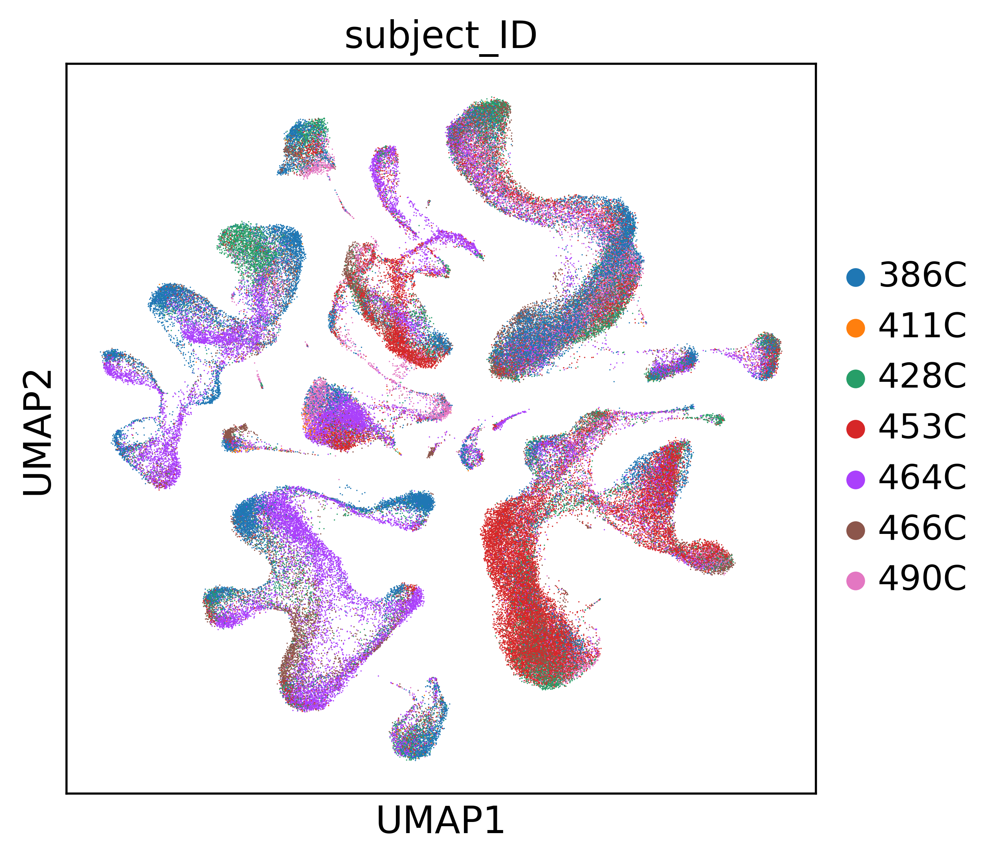

In [88]:
data_latent = lataq_query.get_latent(
    adata_raw.X.A, 
    adata_raw.obs[condition_key].values
)
adata_latent = sc.AnnData(data_latent)
adata_latent.obs = adata_raw.obs.copy()
adata_latent.obs['pred'] = results_dict['ann_finest_level']['preds']
adata_latent.obs['outcome'] = [
    adata_latent.obs['pred'].iloc[i] in ct_map[adata_latent.obs['ann_finest_level'].iloc[i]] for i in range(len(adata_latent))
]
adata_latent.obs['probs'] = results_dict['ann_finest_level']['probs']
adata_latent.obs['log_probs'] = np.log1p(results_dict['ann_finest_level']['probs'])
#adata_latent_sub = sc.pp.subsample(adata_latent, n_obs=20000, copy=True)
adata_latent_sub = adata_latent
sc.pp.neighbors(adata_latent_sub, n_neighbors=15)
sc.tl.umap(adata_latent_sub)
sc.pl.umap(adata_latent_sub, color='subject_ID')

In [89]:
plt.rcParams['figure.dpi'] = 250

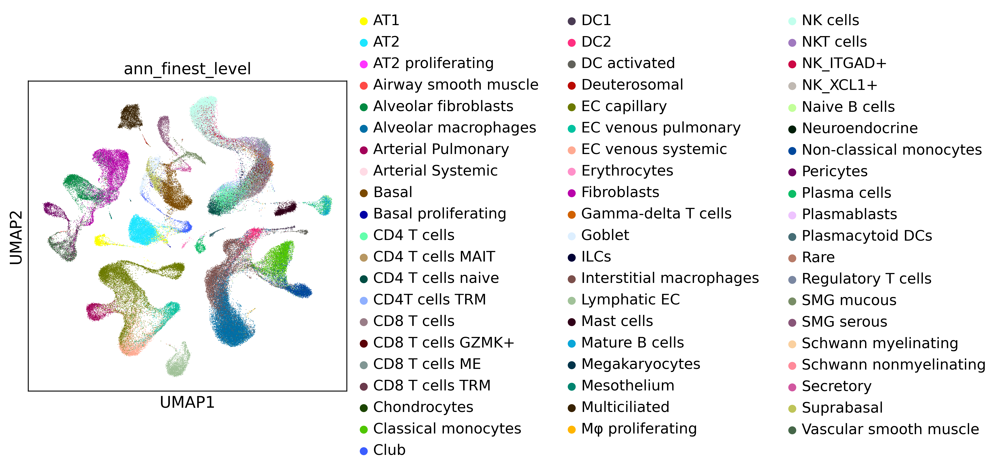

In [90]:
sc.pl.umap(adata_latent_sub, color='ann_finest_level')

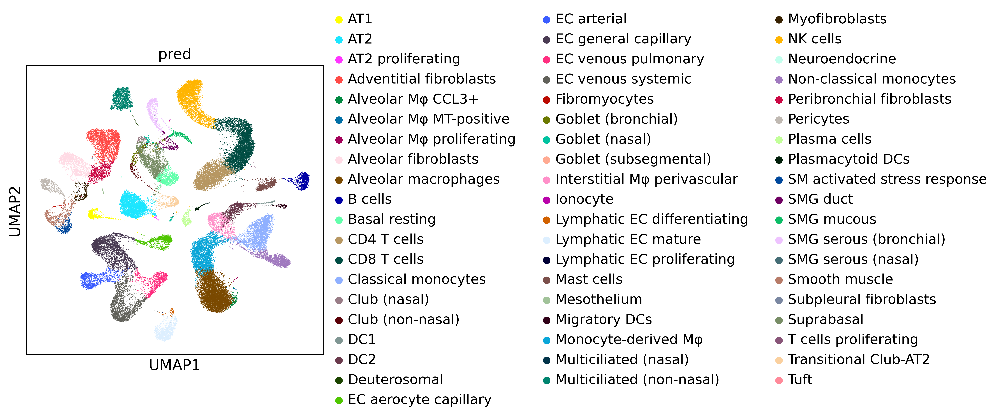

In [91]:
sc.pl.umap(adata_latent_sub, color='pred')

... storing 'outcome' as categorical


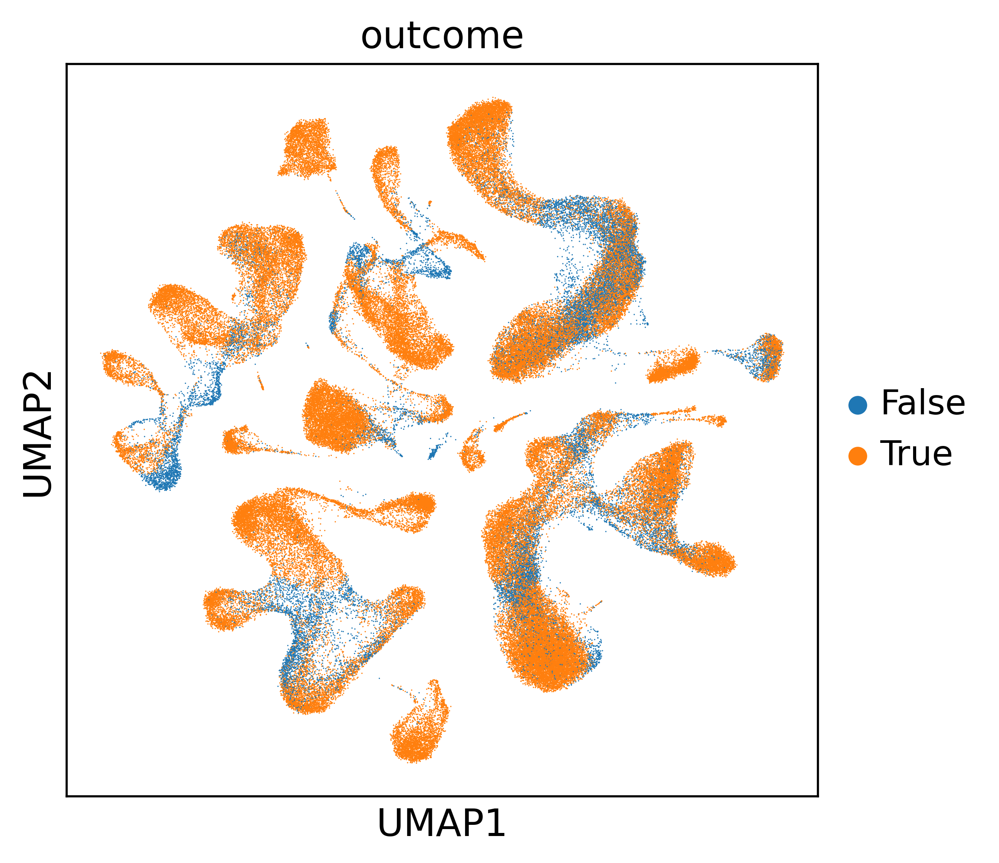

0.0


In [92]:
adata_latent_sub.obs['outcome'] = adata_latent_sub.obs['outcome'].astype(str)
sc.pl.umap(adata_latent_sub, color='outcome')
print(np.sum(adata_latent.obs['outcome'] == True) / len(adata_latent))

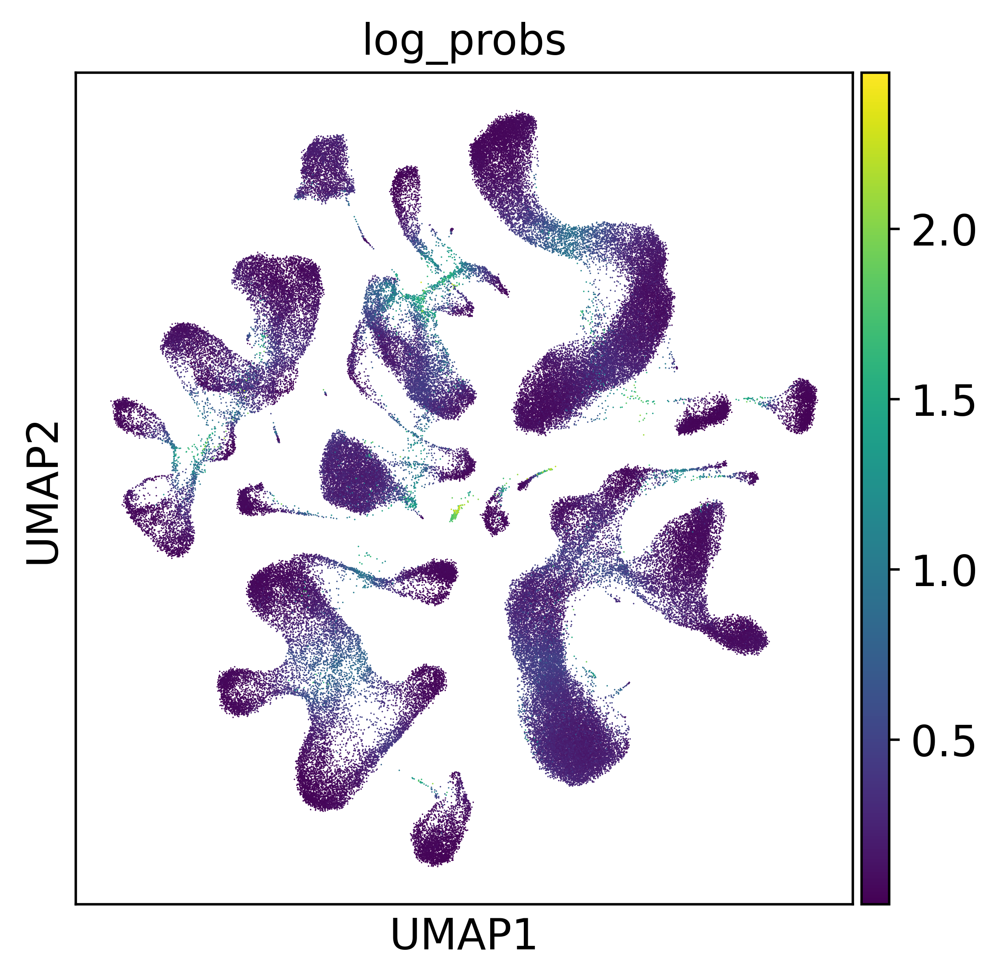

In [93]:
sc.pl.umap(adata_latent_sub, color='log_probs')

In [101]:
adata_latent.obs['outcome'] = [
    adata_latent.obs['pred'].iloc[i] in ct_map[adata_latent.obs['ann_finest_level'].iloc[i]] for i in range(len(adata_latent))
]
adata_latent.obs['high_uncert'] = (adata_latent.obs['log_probs'] > 0.55)
adata_latent.obs['outcome'][adata_latent.obs['high_uncert']] = False

<ipython-input-101-0dd4652c9909>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_latent.obs['outcome'][adata_latent.obs['high_uncert']] = False


In [102]:
listdict = []
for ct in adata_latent.obs['ann_finest_level'].unique():
    acc = (
        np.sum(
            adata_latent.obs[adata_latent.obs['ann_finest_level'] == ct]['outcome'] == True
        )
        / len(adata_latent.obs[adata_latent.obs['ann_finest_level'] == ct])
    )
    unkn = (
        np.sum(
            adata_latent.obs[adata_latent.obs['ann_finest_level'] == ct]['high_uncert'] == True
        )
        / len(adata_latent.obs[adata_latent.obs['ann_finest_level'] == ct])
    )
    listdict.append({
        'ct': ct,
        'acc': acc,
        'unknown': unkn,
        'n_cells': len(adata_latent.obs[adata_latent.obs['ann_finest_level'] == ct]),
    })

acc = (
    np.sum(
        adata_latent.obs['outcome'] == True
    )
    / len(adata_latent)
)
unkn = (
    np.sum(
        adata_latent.obs['high_uncert'] == True
    )
    / len(adata_latent.obs)
)
listdict.append({
    'ct': 'overall',
    'acc': acc,
    'unknown': unkn,
    'n_cells': len(adata_latent),
})

df = pd.DataFrame(listdict).set_index('ct').sort_values(by='ct')
df['wrong'] = 1 - df['acc'] - df['unknown']

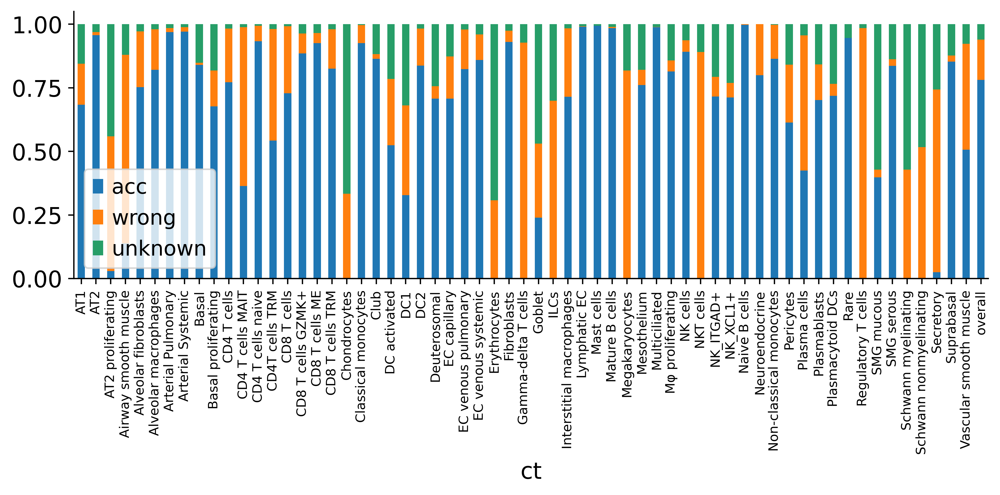

In [103]:
fig, ax = plt.subplots(1, 1, figsize=(10, 3))

df[['acc', 'wrong', 'unknown']].plot(kind='bar', stacked=True, ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
ax.grid(False)
sns.despine()

In [104]:
new_cts = [
    'Chondrocytes',
    'Erythrocytes', 
    'Regulatory T cells',
    'NKT cells', 
    'ILCs', 
    'Megakaryocytes',
    'Schwann myelinating',
    'Schwann nonmyelinating',
]
listdict = []
for ct in new_cts:
    acc = (
        np.sum(
            adata_latent.obs[adata_latent.obs['ann_finest_level'] == ct]['outcome'] == True
        )
        / len(adata_latent.obs[adata_latent.obs['ann_finest_level'] == ct])
    )
    unkn = (
        np.sum(
            adata_latent.obs[adata_latent.obs['ann_finest_level'] == ct]['high_uncert'] == True
        )
        / len(adata_latent.obs[adata_latent.obs['ann_finest_level'] == ct])
    )
    listdict.append({
        'ct': ct,
        'acc': acc,
        'unknown': unkn,
        'n_cells': len(adata_latent.obs[adata_latent.obs['ann_finest_level'] == ct]),
    })

acc = (
    np.sum(
        adata_latent[adata_latent.obs['ann_finest_level'].isin(new_cts)].obs['outcome'] == True
    )
    / len(adata_latent[adata_latent.obs['ann_finest_level'].isin(new_cts)])
)
unkn = (
    np.sum(
        adata_latent[adata_latent.obs['ann_finest_level'].isin(new_cts)].obs['high_uncert'] == True
    )
    / len(adata_latent[adata_latent.obs['ann_finest_level'].isin(new_cts)].obs)
)
listdict.append({
    'ct': 'overall',
    'acc': acc,
    'unknown': unkn,
    'n_cells': len(adata_latent[adata_latent.obs['ann_finest_level'].isin(new_cts)].obs),
})

df_new = pd.DataFrame(listdict).set_index('ct').sort_values(by='ct')
df_new['wrong'] = 1 - df_new['acc'] - df_new['unknown']

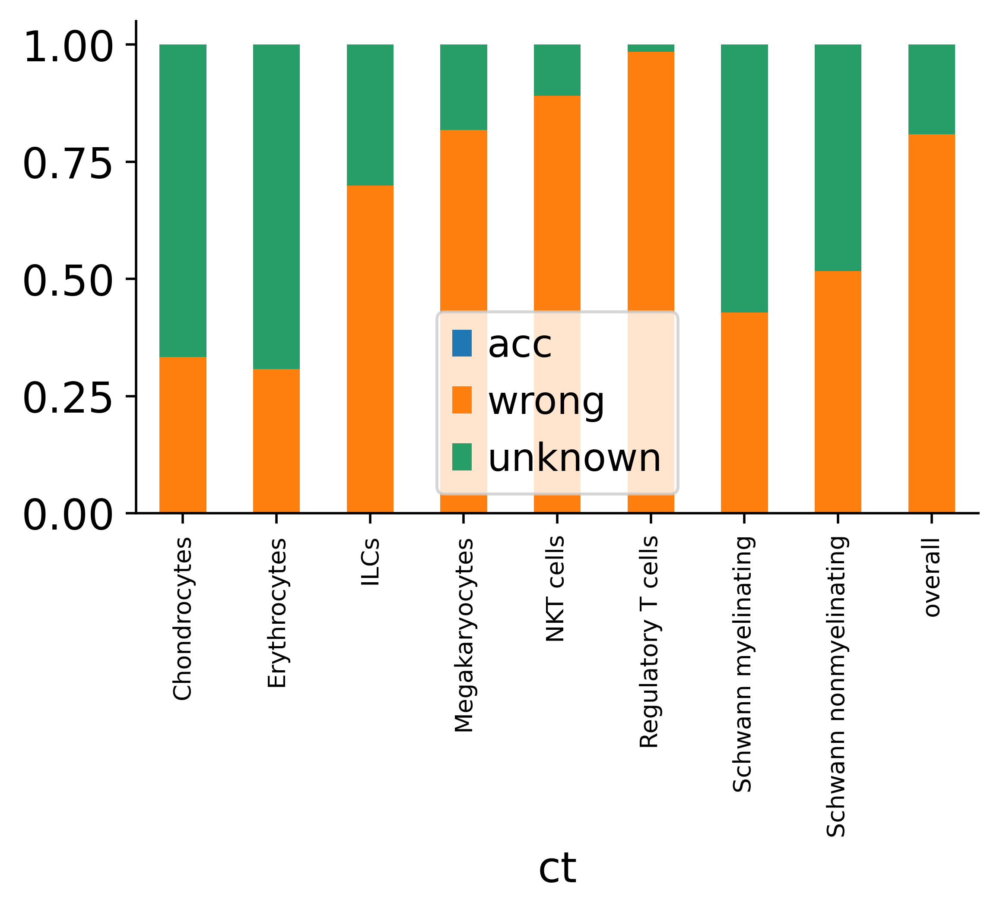

In [105]:
fig, ax = plt.subplots(1, 1, figsize=(5, 3))

df_new[['acc', 'wrong', 'unknown']].plot(kind='bar', stacked=True, ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
ax.grid(False)
sns.despine()

In [106]:
adata_latent_sub.obs['high_uncert'] = (adata_latent_sub.obs['log_probs'] > 0.5)
adata_latent_sub.obs['log_probs'] = (np.log1p(adata_latent_sub.obs['probs']))
adata_latent_sub.obs['high_uncert'] = adata_latent_sub.obs['high_uncert'].astype(str)

... storing 'high_uncert' as categorical


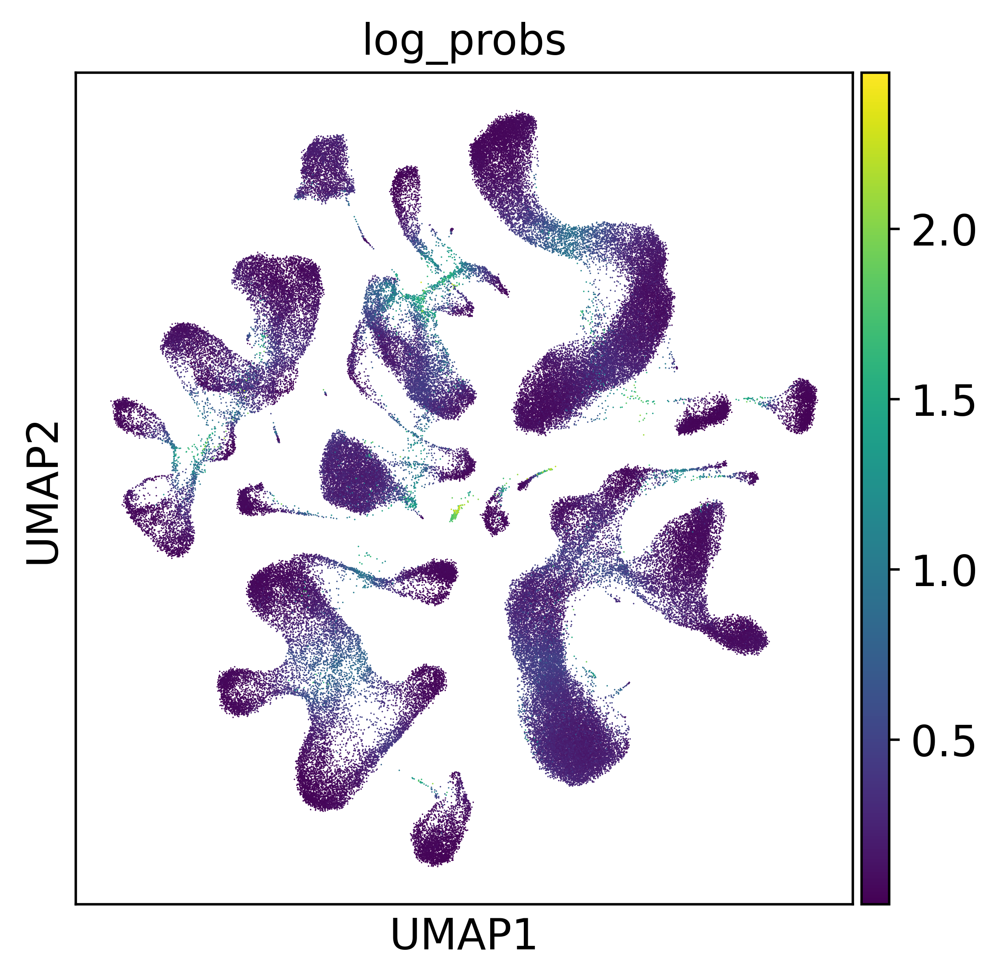

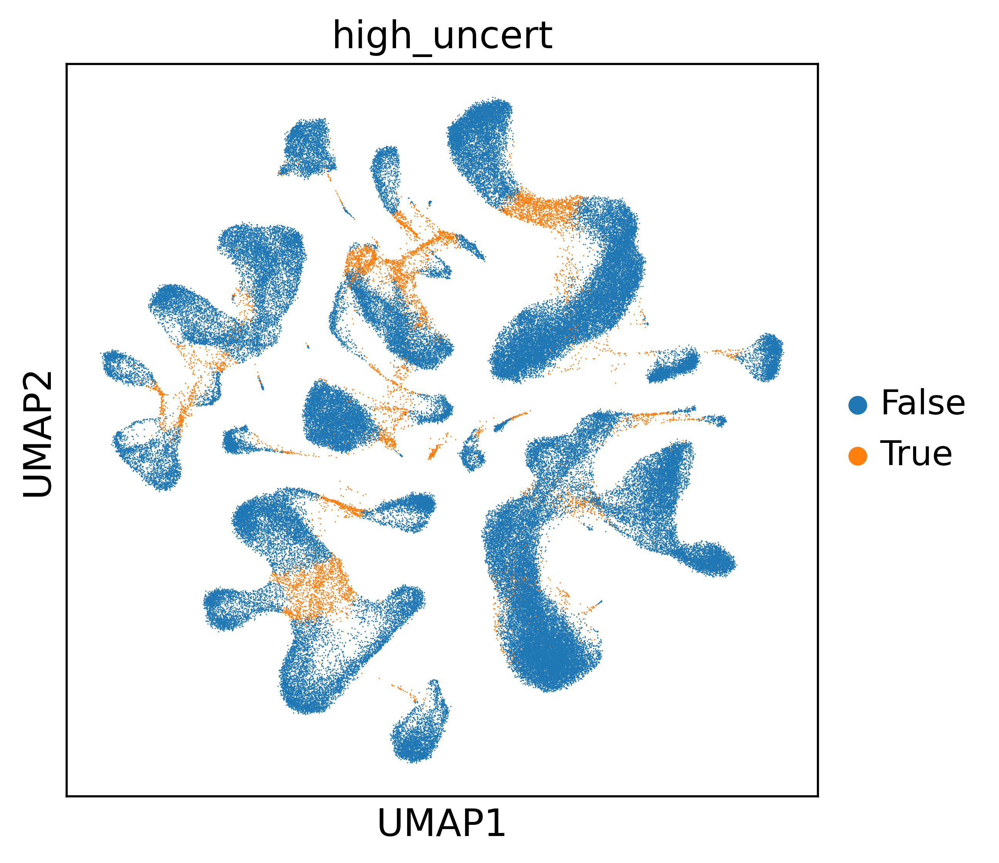

In [107]:
sc.pl.umap(adata_latent_sub, color='log_probs')
sc.pl.umap(adata_latent_sub, color='high_uncert')

In [108]:
labeled_set_euclidean = lataq_query.get_landmarks_info()
labeled_set_euclidean.obs[condition_key] = 'labeled landmark euclidean'
unlabeled_set_euclidean = lataq_query.get_landmarks_info(landmark_set='unlabeled')
unlabeled_set_euclidean.obs[condition_key] = 'unlabeled landmark euclidean'

In [109]:
full_latent = adata_latent_sub.concatenate([
    labeled_set_euclidean, 
    unlabeled_set_euclidean,
])
full_latent

AnnData object with n_obs × n_vars = 128734 × 50
    obs: 'sample', 'original_celltype_ann', 'study_long', 'study', 'last_author_PI', 'subject_ID', 'subject_ID_as_published', 'pre_or_postnatal', 'age_in_years', 'age_range', 'sex', 'ethnicity', 'mixed_ethnicity', 'smoking_status', 'smoking_history', 'BMI', 'known_lung_disease', 'condition', 'subject_type', 'cause_of_death', 'sample_type', 'anatomical_region_coarse', 'anatomical_region_detailed', 'tissue_dissociation_protocol', 'cells_or_nuclei', 'single_cell_platform', "3'_or_5'", 'enrichment', 'sequencing_platform', 'reference_genome_coarse', 'ensembl_release_reference_genome', 'cell_ranger_version', 'disease_status', 'fresh_or_frozen', 'cultured', 'cell_viability_%', 'comments', 'Processing_site', 'dataset', 'anatomical_region_level_1', 'anatomical_region_level_2', 'anatomical_region_level_3', 'anatomical_region_highest_res', 'age', 'original_ann_level_1', 'original_ann_level_2', 'original_ann_level_3', 'original_ann_level_4', 'origin

In [110]:
sc.pp.pca(full_latent)
sc.pp.neighbors(full_latent)
sc.tl.leiden(full_latent)
sc.tl.umap(full_latent)

labeled landmark euclidean


... storing 'sample' as categorical
... storing 'original_celltype_ann' as categorical
... storing 'study_long' as categorical
... storing 'study' as categorical
... storing 'last_author_PI' as categorical
... storing 'subject_ID' as categorical
... storing 'subject_ID_as_published' as categorical
... storing 'pre_or_postnatal' as categorical
... storing 'age_range' as categorical
... storing 'sex' as categorical
... storing 'ethnicity' as categorical
... storing 'mixed_ethnicity' as categorical
... storing 'smoking_status' as categorical
... storing 'smoking_history' as categorical
... storing 'known_lung_disease' as categorical
... storing 'condition' as categorical
... storing 'subject_type' as categorical
... storing 'cause_of_death' as categorical
... storing 'sample_type' as categorical
... storing 'anatomical_region_coarse' as categorical
... storing 'anatomical_region_detailed' as categorical
... storing 'tissue_dissociation_protocol' as categorical
... storing 'cells_or_nuclei

unlabeled landmark euclidean


Trying to set attribute `.uns` of view, copying.
<ipython-input-111-781d47293d61>:31: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  fig.tight_layout()


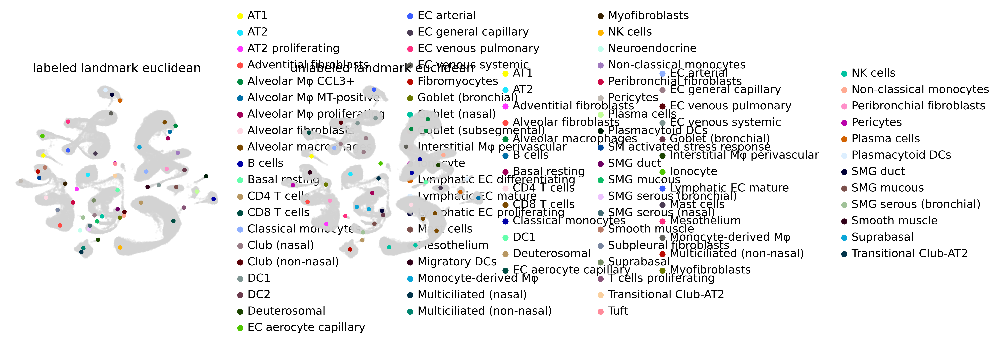

In [111]:
landmark_keys = [
    "labeled landmark euclidean",
    "unlabeled landmark euclidean"
]
cell_type_coldict = adata_latent_sub.uns['pred_colors']
fig, ax = plt.subplots(1, 2, figsize=(10, 4))
ax = ax.flatten()
sc.pp.pca(full_latent)
for i, key in enumerate(landmark_keys):
    print(key)
    sc.pl.umap(
        full_latent, 
        #color=cell_type_key,
        size=20,
        alpha=0.2, 
        show=False, 
        palette=cell_type_coldict,
        ax=ax[i]
    )
    ax[i].legend([])
    sc.pl.umap(
        full_latent[full_latent.obs[condition_key] == key],
        size=100,
        color=[cell_type_key[0] + '_pred'],
        ax=ax[i],
        show=False,
        palette=cell_type_coldict,
        frameon=False,
    )
    ax[i].set_title(key)
fig.tight_layout()

Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
<ipython-input-112-37242b42b03f>:31: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


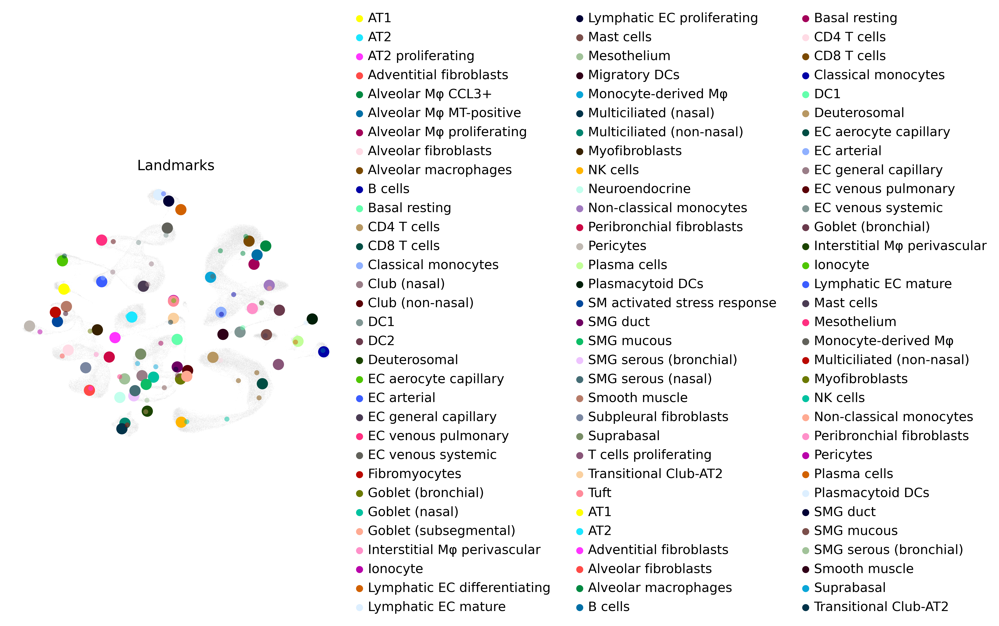

In [112]:
fig, ax = plt.subplots(1, 1, figsize=(6, 5))
sc.pl.umap(
    full_latent, 
    #color=cell_type_key,
    alpha=0.2, 
    show=False, 
    palette=cell_type_coldict,
    ax=ax
)
ax.legend([])
sc.pl.umap(
    full_latent[full_latent.obs[condition_key] == 'labeled landmark euclidean'],
    size=500,
    color=[cell_type_key[0] + '_pred'],
    ax=ax,
    show=False,
    palette=cell_type_coldict,
    frameon=False,
)
sc.pl.umap(
    full_latent[full_latent.obs[condition_key] == 'unlabeled landmark euclidean'],
    size=100,
    color=[cell_type_key[0] + '_pred'],
    ax=ax,
    show=False,
    palette=cell_type_coldict,
    frameon=False,
    alpha=0.5,
)
ax.set_title('Landmarks')
fig.tight_layout()

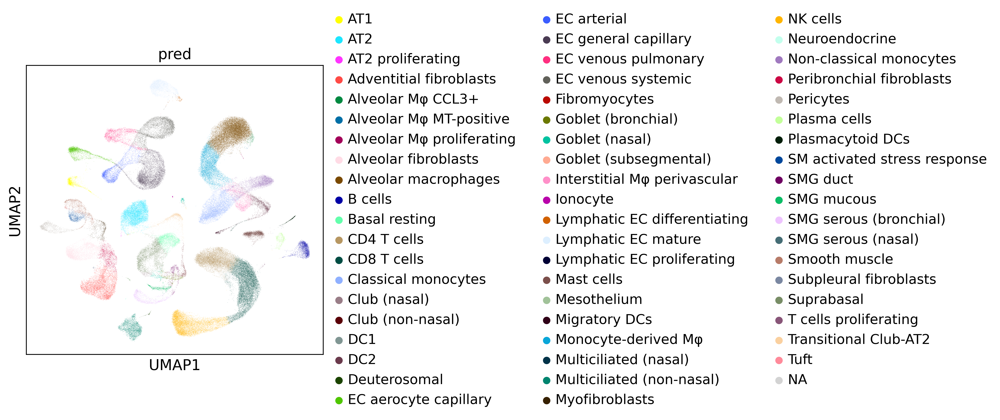

In [113]:
sc.pl.umap(
    full_latent, 
    color='pred',
    alpha=0.2, 
    palette=cell_type_coldict
)

In [114]:
for i in range(len(cell_type_key)):
    preds = results_dict[cell_type_key[i]]['preds']
    probs = results_dict[cell_type_key[i]]['probs']
    classification_df = pd.DataFrame(
        classification_report(
            y_true=adata_raw.obs[cell_type_key[i]], 
            y_pred=preds,
            output_dict=True
        )
    ).transpose()

/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(a

In [115]:
classification_df

,precision,recall,f1-score,support
AT1,0.961136,0.734018,0.832362,1752.000000
AT2,0.941548,0.978820,0.959822,6846.000000
AT2 proliferating,0.066667,0.058824,0.062500,34.000000
Adventitial fibroblasts,0.000000,0.000000,0.000000,0.000000
Airway smooth muscle,0.000000,0.000000,0.000000,58.000000
...,...,...,...,...
Tuft,0.000000,0.000000,0.000000,0.000000
Vascular smooth muscle,0.000000,0.000000,0.000000,1931.000000
accuracy,0.434244,0.434244,0.434244,0.434244
macro avg,0.174285,0.187589,0.173261,128628.000000


In [116]:
embedding = lataq_query.model.embedding.weight.detach().cpu().numpy()
from sklearn.decomposition import KernelPCA
pca = KernelPCA(n_components=2, kernel='cosine')
emb_pca = pca.fit_transform(embedding)


/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y, hue. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


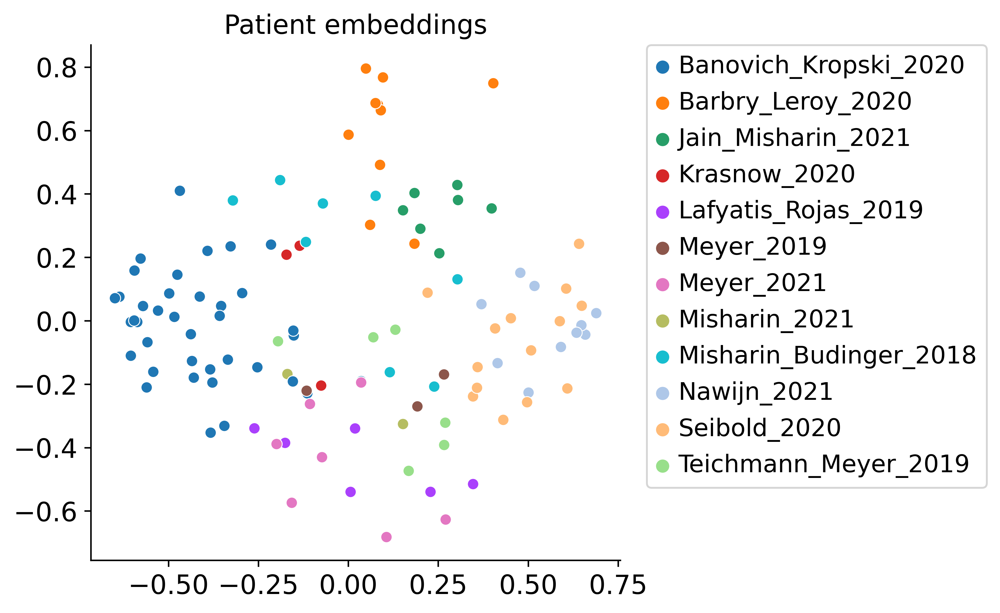

In [117]:
from sklearn.decomposition import KernelPCA

plot_key = 'study'
embedding = lataq_query.model.embedding.weight.detach().cpu().numpy()
pca = KernelPCA(n_components=5, kernel='cosine')
emb_pca = pca.fit_transform(embedding)
cond = (
    adata
    .obs
    .groupby(condition_key)
    .first()
    .reindex(lataq_query.conditions_)
    [plot_key]
)
patient_id = lataq_query.conditions_

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
import seaborn as sns
sns.scatterplot(
    emb_pca[:, 0], 
    emb_pca[:, 1], 
    cond,
    #hue_order = cond_to_keep,
    #palette = 'Reds',
    ax=ax
)

#for i in range(emb_pca.shape[0]):
#    ax.text(
#        x=emb_pca[i, 0]+0.01,
#        y=emb_pca[i, 1]+0.01,
#        s=patient_id[i],
#        fontsize=5
#    )
ax.grid(False)
ax.set_title('Patient embeddings')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
sns.despine()

In [58]:
lataq_query.conditions_

['Donor_05',
 'donor 2',
 'Donor_07',
 'T164',
 'donor 3',
 'donor 1',
 'VUHD103',
 'GRO-03',
 'GRO-10',
 'Donor_03',
 'VUHD68',
 'NU_CZI02',
 'VUHD92',
 'T165',
 'VUHD67',
 'Donor_06',
 'T121',
 'D363',
 'GRO-08',
 '296C',
 'lafy_donor_1',
 'VUHD071',
 '302C',
 'THD0012',
 'lafy_donor_6',
 'D372',
 '368C',
 'GRO-06',
 'GRO-01',
 'GRO-02',
 'T154',
 'NU_CZI01',
 'D326',
 'GRO-09',
 'VUHD94',
 '390C',
 'THD0009',
 '2020-3173-NC004',
 'VUHD70',
 'T90',
 'THD0005',
 'T166',
 'T89',
 'D353',
 'D337',
 'D354',
 'D344',
 '290B',
 '356C',
 'Donor_04',
 'lafy_donor_3',
 'VUHD98',
 '2020-3173-NC008',
 'D339',
 'lafy_donor_4',
 'Donor_08',
 'D367',
 'VUHD95',
 'Donor_01',
 'T137',
 'THD0019',
 'THD0015',
 '2020-3173-NC006',
 '2020-3173-NC002',
 'VUHD106',
 'THD0007',
 'T120',
 'THD0008',
 'D322',
 'VUHD104',
 'Donor_02',
 'VUHD84',
 'VUHD101',
 'T167',
 'THD0020',
 'T85',
 'THD0001',
 'THD0006',
 'VUHD66',
 'GRO-04',
 'T101',
 'THD0017',
 'T126',
 '2020-3173-NC005',
 'GRO-11',
 'VUHD080',
 '292B

In [59]:
        (adata
        .obs
        .groupby(condition_key)
        .first()
        .reindex(lataq_query.conditions_)[plot_key]
        )

subject_ID
Donor_05    Misharin_Budinger_2018
donor 2               Krasnow_2020
Donor_07    Misharin_Budinger_2018
T164                  Seibold_2020
donor 3               Krasnow_2020
                     ...          
428C                    Meyer_2021
490C                    Meyer_2021
386C                    Meyer_2021
411C                    Meyer_2021
464C                    Meyer_2021
Name: study, Length: 114, dtype: category
Categories (12, object): ['Banovich_Kropski_2020', 'Barbry_Leroy_2020', 'Jain_Misharin_2021', 'Krasnow_2020', ..., 'Misharin_Budinger_2018', 'Nawijn_2021', 'Seibold_2020', 'Teichmann_Meyer_2019']

/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y, hue. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


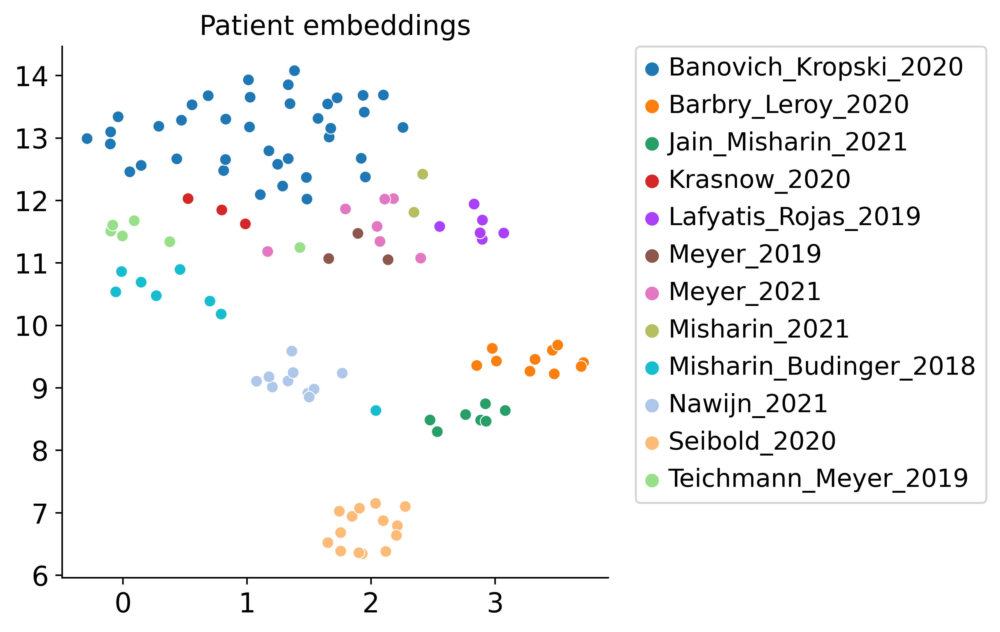

In [123]:
from sklearn.decomposition import KernelPCA
from umap import UMAP

plot_key = 'study'
embedding = lataq_query.model.embedding.weight.detach().cpu().numpy()
umap = UMAP(n_neighbors=20)
emb_pca = umap.fit_transform(embedding, )

cond = (
    adata
    .obs
    .groupby(condition_key)
    .first()
    .reindex(lataq_query.conditions_)
    [plot_key]
)
patient_id = lataq_query.conditions_

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
import seaborn as sns
sns.scatterplot(
    emb_pca[:, 0], 
    emb_pca[:, 1], 
    cond,
    #hue_order = cond_to_keep,
    #palette = 'Reds',
    ax=ax
)

#for i in range(emb_pca.shape[0]):
#    ax.text(
#        x=emb_pca[i, 0]+0.01,
#        y=emb_pca[i, 1]+0.01,
#        s=patient_id[i],
#        fontsize=5
#    )
ax.grid(False)
ax.set_title('Patient embeddings')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
sns.despine()

In [121]:
adata.obs.columns

Index(['sample', 'original_celltype_ann', 'study_long', 'study',
       'last_author_PI', 'subject_ID', 'subject_ID_as_published',
       'pre_or_postnatal', 'age_in_years', 'age_range', 'sex', 'ethnicity',
       'mixed_ethnicity', 'smoking_status', 'smoking_history', 'BMI',
       'known_lung_disease', 'condition', 'subject_type', 'cause_of_death',
       'sample_type', 'anatomical_region_coarse', 'anatomical_region_detailed',
       'tissue_dissociation_protocol', 'cells_or_nuclei',
       'single_cell_platform', '3'_or_5'', 'enrichment', 'sequencing_platform',
       'reference_genome_coarse', 'ensembl_release_reference_genome',
       'cell_ranger_version', 'disease_status', 'fresh_or_frozen', 'cultured',
       'cell_viability_%', 'comments', 'Processing_site', 'dataset',
       'anatomical_region_level_1', 'anatomical_region_level_2',
       'anatomical_region_level_3', 'anatomical_region_highest_res', 'age',
       'original_ann_level_1', 'original_ann_level_2', 'original_ann_l

/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y, hue. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


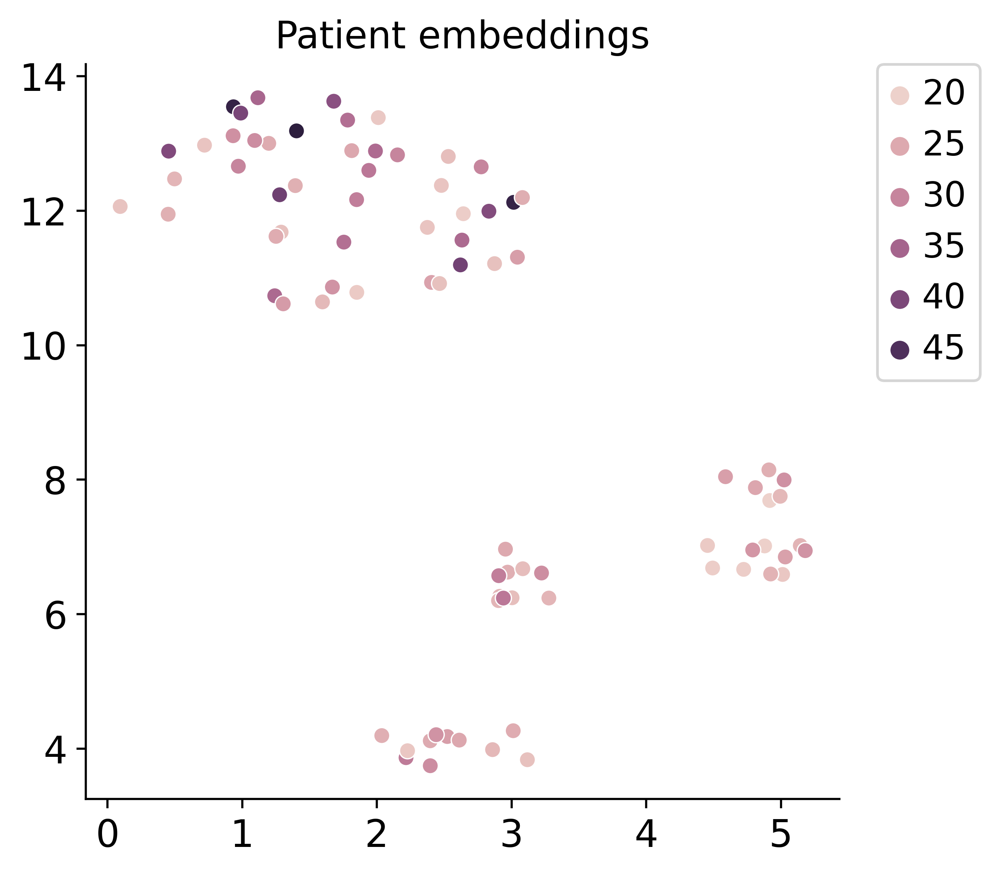

In [122]:
plot_key = 'BMI'
embedding = lataq_query.model.embedding.weight.detach().cpu().numpy()
umap = UMAP()
emb_pca = umap.fit_transform(embedding)
cond = (
    adata
    .obs
    .groupby(condition_key)
    .first()
    .reindex(lataq_query.conditions_)
    [plot_key]
)
patient_id = lataq_query.conditions_

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
import seaborn as sns
sns.scatterplot(
    emb_pca[:, 0], 
    emb_pca[:, 1], 
    cond,
    #hue_order = cond_to_keep,
    #palette = 'Reds',
    ax=ax
)

#for i in range(emb_pca.shape[0]):
#    ax.text(
#        x=emb_pca[i, 0]+0.01,
#        y=emb_pca[i, 1]+0.01,
#        s=patient_id[i],
#        fontsize=5
#    )
ax.grid(False)
ax.set_title('Patient embeddings')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
sns.despine()

In [65]:
adata.obs.columns

Index(['sample', 'original_celltype_ann', 'study_long', 'study',
       'last_author_PI', 'subject_ID', 'subject_ID_as_published',
       'pre_or_postnatal', 'age_in_years', 'age_range', 'sex', 'ethnicity',
       'mixed_ethnicity', 'smoking_status', 'smoking_history', 'BMI',
       'known_lung_disease', 'condition', 'subject_type', 'cause_of_death',
       'sample_type', 'anatomical_region_coarse', 'anatomical_region_detailed',
       'tissue_dissociation_protocol', 'cells_or_nuclei',
       'single_cell_platform', '3'_or_5'', 'enrichment', 'sequencing_platform',
       'reference_genome_coarse', 'ensembl_release_reference_genome',
       'cell_ranger_version', 'disease_status', 'fresh_or_frozen', 'cultured',
       'cell_viability_%', 'comments', 'Processing_site', 'dataset',
       'anatomical_region_level_1', 'anatomical_region_level_2',
       'anatomical_region_level_3', 'anatomical_region_highest_res', 'age',
       'original_ann_level_1', 'original_ann_level_2', 'original_ann_l

/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y, hue. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


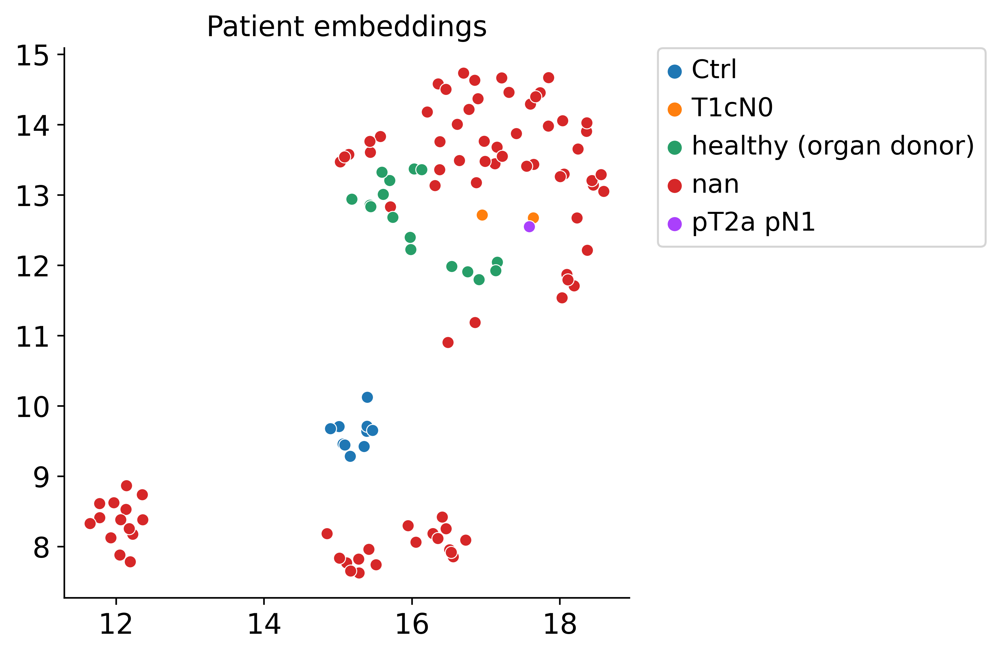

In [74]:
plot_key = 'disease_status'
embedding = lataq_query.model.embedding.weight.detach().cpu().numpy()
umap = UMAP()
emb_pca = umap.fit_transform(embedding)
cond = (
    adata
    .obs
    .groupby(condition_key)
    .first()
    .reindex(lataq_query.conditions_)
    [plot_key]
)
patient_id = lataq_query.conditions_

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
import seaborn as sns
sns.scatterplot(
    emb_pca[:, 0], 
    emb_pca[:, 1], 
    cond,
    #hue_order = cond_to_keep,
    #palette = 'Reds',
    ax=ax
)

#for i in range(emb_pca.shape[0]):
#    ax.text(
#        x=emb_pca[i, 0]+0.01,
#        y=emb_pca[i, 1]+0.01,
#        s=patient_id[i],
#        fontsize=5
#    )
ax.grid(False)
ax.set_title('Patient embeddings')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
sns.despine()

/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y, hue. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


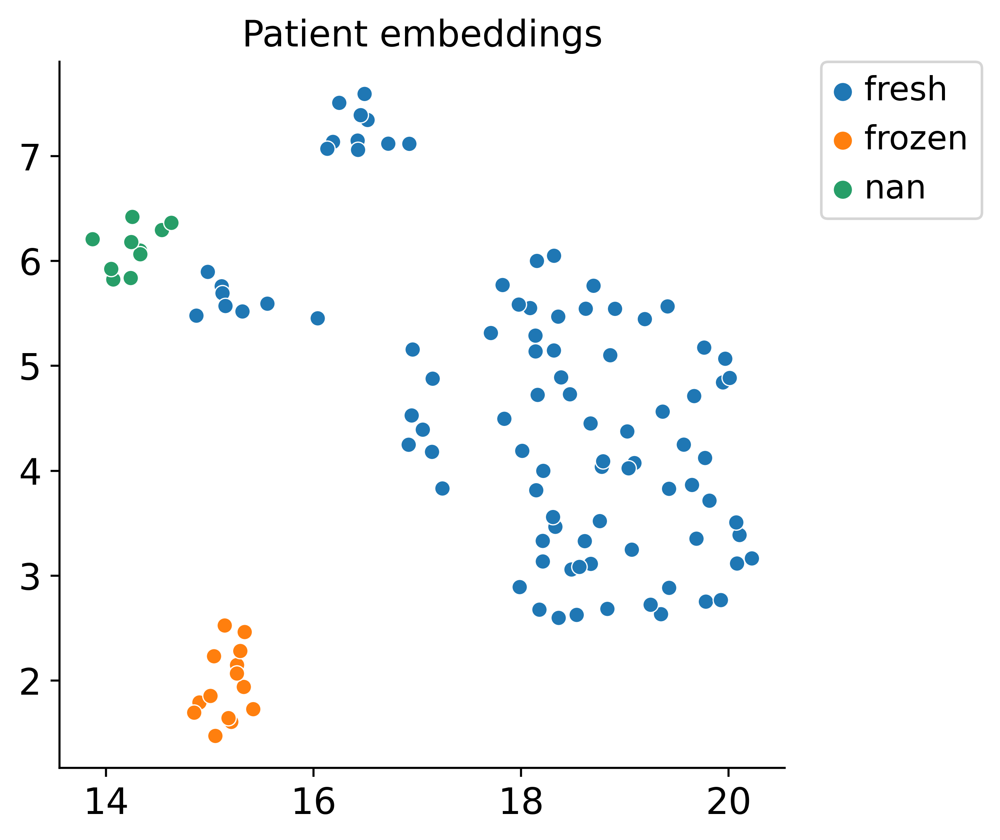

In [75]:
plot_key = 'fresh_or_frozen'
embedding = lataq_query.model.embedding.weight.detach().cpu().numpy()
umap = UMAP()
emb_pca = umap.fit_transform(embedding)
cond = (
    adata
    .obs
    .groupby(condition_key)
    .first()
    .reindex(lataq_query.conditions_)
    [plot_key]
)
patient_id = lataq_query.conditions_

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
import seaborn as sns
sns.scatterplot(
    emb_pca[:, 0], 
    emb_pca[:, 1], 
    cond,
    #hue_order = cond_to_keep,
    #palette = 'Reds',
    ax=ax
)

#for i in range(emb_pca.shape[0]):
#    ax.text(
#        x=emb_pca[i, 0]+0.01,
#        y=emb_pca[i, 1]+0.01,
#        s=patient_id[i],
#        fontsize=5
#    )
ax.grid(False)
ax.set_title('Patient embeddings')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
sns.despine()

In [126]:
embedding = lataq_query.model.embedding.weight.detach().cpu().numpy()
umap = UMAP(n_neighbors=20)
emb_pca = umap.fit_transform(embedding, )

/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y, hue. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


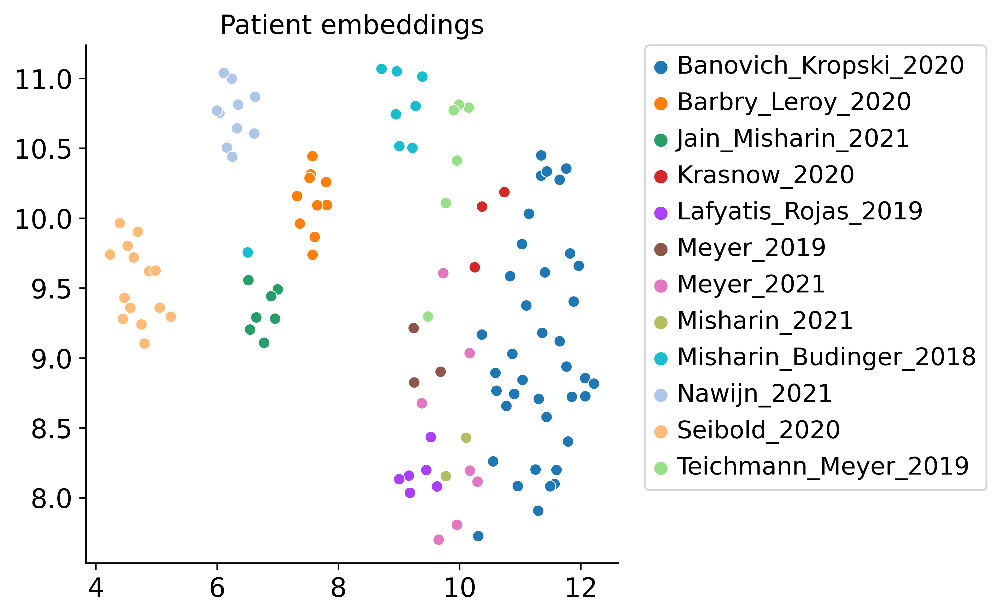

In [129]:
plot_key = 'study'

cond = (
    adata
    .obs
    .groupby(condition_key)
    .first()
    .reindex(lataq_query.conditions_)
    [plot_key]
)
patient_id = lataq_query.conditions_

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
import seaborn as sns
sns.scatterplot(
    emb_pca[:, 0], 
    emb_pca[:, 1], 
    cond,
    #hue_order = cond_to_keep,
    #palette = 'Reds',
    ax=ax
)

#for i in range(emb_pca.shape[0]):
#    ax.text(
#        x=emb_pca[i, 0]+0.01,
#        y=emb_pca[i, 1]+0.01,
#        s=patient_id[i],
#        fontsize=5
#    )
ax.grid(False)
ax.set_title('Patient embeddings')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
sns.despine()

/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y, hue. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


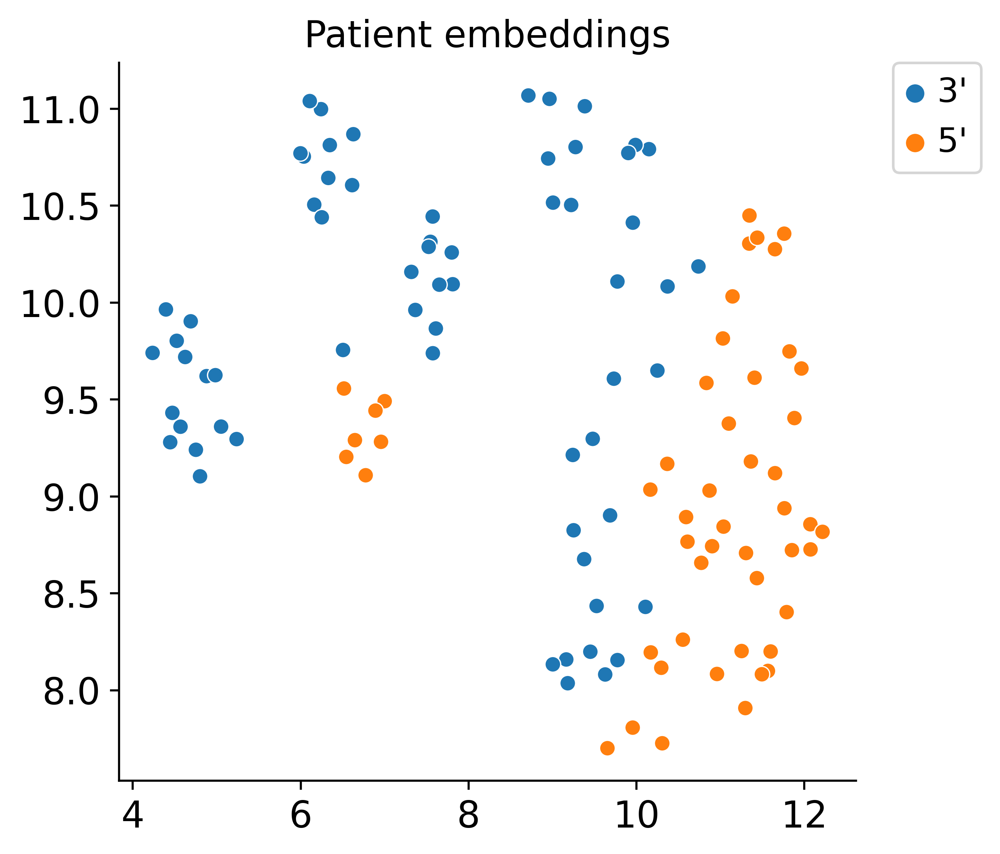

In [127]:
plot_key = '3\'_or_5\''
from sklearn.decomposition import KernelPCA
from umap import UMAP



cond = (
    adata
    .obs
    .groupby(condition_key)
    .first()
    .reindex(lataq_query.conditions_)
    [plot_key]
)
patient_id = lataq_query.conditions_

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
import seaborn as sns
sns.scatterplot(
    emb_pca[:, 0], 
    emb_pca[:, 1], 
    cond,
    #hue_order = cond_to_keep,
    #palette = 'Reds',
    ax=ax
)

#for i in range(emb_pca.shape[0]):
#    ax.text(
#        x=emb_pca[i, 0]+0.01,
#        y=emb_pca[i, 1]+0.01,
#        s=patient_id[i],
#        fontsize=5
#    )
ax.grid(False)
ax.set_title('Patient embeddings')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
sns.despine()

/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y, hue. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


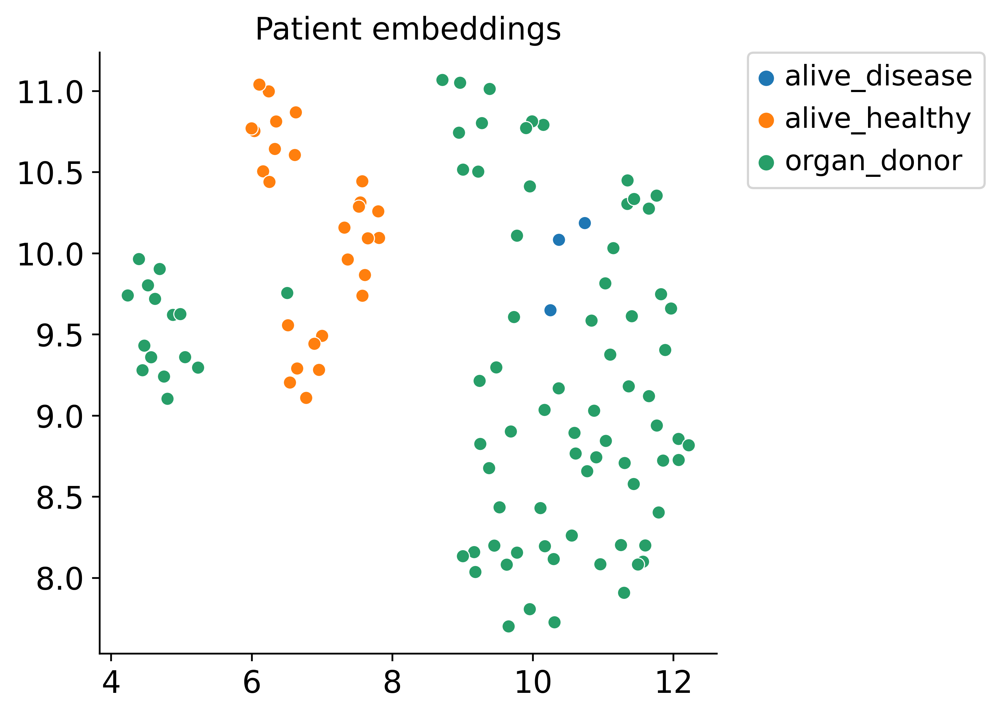

In [128]:
plot_key = 'subject_type'

cond = (
    adata
    .obs
    .groupby(condition_key)
    .first()
    .reindex(lataq_query.conditions_)
    [plot_key]
)
patient_id = lataq_query.conditions_

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
import seaborn as sns
sns.scatterplot(
    emb_pca[:, 0], 
    emb_pca[:, 1], 
    cond,
    #hue_order = cond_to_keep,
    #palette = 'Reds',
    ax=ax
)

#for i in range(emb_pca.shape[0]):
#    ax.text(
#        x=emb_pca[i, 0]+0.01,
#        y=emb_pca[i, 1]+0.01,
#        s=patient_id[i],
#        fontsize=5
#    )
ax.grid(False)
ax.set_title('Patient embeddings')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
sns.despine()